In [137]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from datetime import datetime, timedelta
from sklearn.model_selection import train_test_split
import seaborn as sns
import json

## Data preprocessing

### Original dataset with garden_door and hallway_door

In [138]:
# Load and preprocess door and window data
garden_door_df = pd.read_csv('datasets/Door_windows.csv')
garden_door_df = garden_door_df.drop('Door_balcony_1st_floor', axis=1)
garden_door_df = garden_door_df.drop('Door_Hallway', axis=1)
garden_door_df['Date'] = pd.to_datetime(garden_door_df['Date'], format='%d/%m/%Y %H:%M')
garden_door_df['Door_Garden'] = garden_door_df['Door_Garden'].map({'on': 1, 'off': 0})
garden_door_df = garden_door_df.drop_duplicates(subset='Date', keep='last')

# RESAMPLANJE U 1 SEKUNDU
garden_door_df.set_index('Date', inplace=True)
garden_door_df = garden_door_df.resample('1s').ffill()
garden_door_df.reset_index(inplace=True)
garden_door_df = garden_door_df.drop('Unnamed: 0', axis=1)
#garden_door_df.to_csv("datasets/garden_door_dataset.csv", index=False)

# Load and preprocess door and window data
hallway_door_df = pd.read_csv('datasets/Door_windows.csv')
hallway_door_df = hallway_door_df.drop('Door_balcony_1st_floor', axis=1)
hallway_door_df = hallway_door_df.drop('Door_Garden', axis=1)
hallway_door_df['Date'] = pd.to_datetime(hallway_door_df['Date'], format='%d/%m/%Y %H:%M')
hallway_door_df['Door_Hallway'] = hallway_door_df['Door_Hallway'].map({'on': 1, 'off': 0})
hallway_door_df = hallway_door_df.drop_duplicates(subset='Date', keep='last')

# RESAMPLANJE U 1 SEKUNDU
hallway_door_df.set_index('Date', inplace=True)
hallway_door_df = hallway_door_df.resample('1s').ffill()
hallway_door_df.reset_index(inplace=True)
hallway_door_df = hallway_door_df.drop('Unnamed: 0', axis=1)
#garden_door_df.to_csv("datasets/garden_door_dataset.csv", index=False)

sensor_df = pd.read_csv('datasets/LS0623020168.csv')
# Convert UTC to UTC+2
sensor_df['timestamp(ZG)'] = pd.to_datetime(sensor_df['timestamp(UTC)']) + timedelta(hours=2)

# Handling daylight savings ZG: (UTC+2) -> (UTC+1)
dst_cutoff = pd.Timestamp('2024-10-27 03:00:00')
sensor_df['timestamp(ZG)'] = sensor_df['timestamp(ZG)'].apply(
    lambda x: x - timedelta(hours=1) if x >= dst_cutoff else x
)

merged_df = pd.merge(sensor_df, garden_door_df[["Date", "Door_Garden"]],
                     left_on="timestamp(ZG)", right_on="Date", how="left")
merged_df = pd.merge(merged_df, hallway_door_df[["Date", "Door_Hallway"]],
                     left_on="timestamp(ZG)", right_on="Date", how="left")
merged_df = merged_df.drop(columns=["Date_x", "Date_y"])
merged_df = merged_df[merged_df["timestamp(ZG)"] >= garden_door_df['Date'].min()]

# Dropping duplicated values of timestamp resulted in moving the clock by 1 hour
merged_df = merged_df.drop_duplicates(subset='timestamp(ZG)', keep='first')
merged_df = merged_df.dropna()

#merged_df.to_csv("datasets/merged_sensor_data.csv", index=False)

### Black Carbon Dataset

In [139]:
ruder_df = pd.read_csv('datasets/Ruder_data.csv', sep=";")
ruder_df['Date and time'] = pd.to_datetime(ruder_df['Date and time'], format='%m/%d/%Y %H:%M:%S')
ruder_df = ruder_df.drop_duplicates(subset="Date and time", keep='last')
ruder_df = ruder_df.set_index('Date and time').resample('1s').interpolate(method='linear').reset_index()
# Merge black carbon data with primary dataset based on timestamps
merged_df = pd.merge_asof(
    merged_df.rename(columns={'timestamp(ZG)': 'timestamp'}).sort_values('timestamp'), 
    ruder_df.rename(columns={'Date and time': 'timestamp'}).sort_values('timestamp'), 
    on='timestamp',
    direction='backward'
).rename(columns={'timestamp': 'timestamp(ZG)'})
#merged_df.to_csv("datasets/merged_sensor_data_with_motion.csv", index=False)

### Motion dataset

In [140]:
motion_df = pd.read_csv('datasets/Motion.csv')
motion_df = motion_df.drop('Unnamed: 0', axis=1)
motion_df['Timestamp'] = pd.to_datetime(motion_df['Timestamp'], format='%Y-%m-%d %H:%M:%S')
motion_df = motion_df.set_index('Timestamp').resample('1s').ffill().reset_index()
# Merge motion detection data with primary dataset based on timestamps
merged_df = pd.merge_asof(
    merged_df.rename(columns={'timestamp(ZG)': 'timestamp'}).sort_values('timestamp'), 
    motion_df.rename(columns={'Timestamp': 'timestamp'}).sort_values('timestamp'), 
    on='timestamp',
    direction='backward'
).rename(columns={'timestamp': 'timestamp(ZG)'})
#merged_df.to_csv("datasets/merged_sensor_data_with_motion.csv", index=False)

### People dataset

In [141]:
people_df = pd.read_csv('datasets/People.csv')
people_df = people_df.drop('Unnamed: 0', axis=1)
people_df.rename(columns={'People in a room' : 'people_in_room'}, inplace= True)
people_df['Timestamp'] = pd.to_datetime(people_df['Timestamp'], format='%Y-%m-%d %H:%M:%S')
people_df = people_df.set_index('Timestamp').resample('1s').ffill().reset_index()
merged_df = pd.merge_asof(
    merged_df.rename(columns={'timestamp(ZG)': 'timestamp'}).sort_values('timestamp'), 
    people_df.rename(columns={'Timestamp': 'timestamp'}).sort_values('timestamp'), 
    on='timestamp',
    direction='backward'
).rename(columns={'timestamp': 'timestamp(ZG)'})

# Fill missing values in 'motion_detection' based on 'people_in_room'
merged_df['Motion_detection'] = merged_df['Motion_detection'].fillna(
    merged_df['people_in_room'].apply(lambda x: 0 if x == 0 else 1)
)

# Adding a "people" column if motion detected or people in room
merged_df['people'] = ((merged_df['Motion_detection'] != 0) | (merged_df['people_in_room'] != 0)).astype(int)

### Adding "Human Presence" Experiment to "People"

In [142]:
human_presence_intervals = [
    ("2024-10-19 12:02", "2024-10-19 12:53"),
    ("2024-10-19 13:34", "2024-10-19 14:08")
]

for start, end in human_presence_intervals:
    start_dt = pd.to_datetime(start)
    end_dt = pd.to_datetime(end)
    merged_df.loc[(merged_df['timestamp(ZG)'] >= start_dt) & (merged_df['timestamp(ZG)'] <= end_dt), 'people'] = 1

# merged_df.to_csv("people_classifier_dataset.csv", index=False)

## Adding a people_continuous based on Human Presence and the real data

In [143]:
# Step 1: Identify intervals when sensor is triggered (people == 1)
# We'll detect state changes to group consecutive 1's.
merged_df['prev'] = merged_df['people'].shift(fill_value=0)
merged_df['change'] = merged_df['people'] != merged_df['prev']

# Get indices where the state changes
change_indices = merged_df.index[merged_df['change']].tolist()

intervals = []
current_state = merged_df.loc[change_indices[0], 'people']
start_time = merged_df.loc[change_indices[0], 'timestamp(ZG)']

for idx in change_indices[1:]:
    state = merged_df.loc[idx, 'people']
    time_val = merged_df.loc[idx, 'timestamp(ZG)']
    if state != current_state:
        # If the state was 1, then record that interval.
        if current_state == 1:
            intervals.append((start_time, time_val))
        start_time = time_val
        current_state = state

# If the last state is 1, record the interval until the end of the DataFrame.
if current_state == 1:
    intervals.append((start_time, merged_df['timestamp(ZG)'].iloc[-1]))

# Step 2: Merge intervals with gaps less than the threshold (5 minutes)
threshold = pd.Timedelta(minutes=15)
merged_intervals = []
if intervals:
    current_start, current_end = intervals[0]
    for start, end in intervals[1:]:
        # If gap between current interval end and next start is less than threshold, merge them.
        if start - current_end < threshold:
            current_end = end  # extend the current interval
        else:
            merged_intervals.append((current_start, current_end))
            current_start, current_end = start, end
    merged_intervals.append((current_start, current_end))

# Step 3: Create a new column with merged people detection.
# Initialize a new column (e.g. "people_merged") to 0.
merged_df['people_continuous'] = 0

# For each merged interval, mark the corresponding rows as 1.
for start, end in merged_intervals:
    merged_df.loc[(merged_df['timestamp(ZG)'] >= start) & (merged_df['timestamp(ZG)'] < end), 'people_continuous'] = 1

# (Optional) Drop helper columns.
merged_df.drop(columns=['prev', 'change'], inplace=True)

# merged_df.to_csv("people_classifier_dataset.csv", index=False)

### Adding experiment column 

In [144]:
with open("datasets/experiments.json", "r") as file:
    experiment_data = json.load(file)

start_time = merged_df['timestamp(ZG)'].min()
end_time = merged_df['timestamp(ZG)'].max()

all_timestamps = pd.date_range(start=start_time, end=end_time, freq="1s")
experiment_df = pd.DataFrame({"Timestamp": all_timestamps, "experiment": 0})

for ranges in experiment_data["experiments"].values():
    for start, end in ranges:
        start, end = pd.to_datetime(start), pd.to_datetime(end)
        experiment_df.loc[(experiment_df['Timestamp'] >= start) & (experiment_df['Timestamp'] <= end), 'experiment'] = 1

merged_df = pd.merge_asof(
    merged_df.rename(columns={'timestamp(ZG)': 'timestamp'}).sort_values('timestamp'), 
    experiment_df.rename(columns={'Timestamp': 'timestamp'}).sort_values('timestamp'), 
    on='timestamp',
    direction='backward'
).rename(columns={'timestamp': 'timestamp(ZG)'})

# merged_df.to_csv("people_classifier_dataset.csv", index=False)

## Adding "burning" from the experiment data

In [ ]:
burning_intervals = [
    ("2024-10-20 13:10", "2024-10-20 13:40"),
    ("2024-10-20 14:00", "2024-10-20 14:30"),
    ("2024-10-20 14:51", "2024-10-20 15:15"),
    # ("2024-11-01 14:50", "2024-11-01 15:05"),
    ("2024-10-20 19:58", "2024-10-20 21:30"),   # test
    ("2024-10-21 08:50", "2024-10-21 09:30"),
    ("2024-10-29 13:24", "2024-10-29 13:39"),
    ("2024-10-29 14:20", "2024-10-29 14:51"),   # test
    ("2024-10-29 14:51", "2024-10-29 15:06")    # test
]

merged_df['burning'] = 0

for start, end in burning_intervals:
    start_dt = pd.to_datetime(start)
    end_dt = pd.to_datetime(end)
    merged_df.loc[(merged_df['timestamp(ZG)'] >= start_dt) & (merged_df['timestamp(ZG)'] <= end_dt), 'burning'] = 1

# merged_df.to_csv("people_classifier_dataset.csv", index=False)

## REMOVING ALL THE LABELED DATA, UNLESS BURNING IS TRUE

In [146]:
# Calculate the original number of rows
original_row_count = merged_df.shape[0]
burning_count = (merged_df['burning'] == 1).sum()
people_count = (merged_df['people_continuous'] == 1).sum()
garden_door_count = (merged_df['Door_Garden'] == 1).sum()
hallway_door_count = (merged_df['Door_Hallway'] == 1).sum()


# Define the columns to check
columns_to_check = ['Door_Garden', 'Door_Hallway', 'experiment', 'people_continuous']

# Apply the filtering condition
merged_df = merged_df[
    ~((merged_df[columns_to_check].any(axis=1)) & (merged_df['burning'] == 0))
]

# Calculate the number of rows remaining after filtering
remaining_row_count = merged_df.shape[0]

# Calculate the number of rows deleted
rows_deleted = original_row_count - remaining_row_count

# Calculate the percentage of rows deleted
percentage_deleted = (rows_deleted / original_row_count) * 100

burning_count2 = (merged_df['burning'] == 1).sum()
people_count2 = (merged_df['people_continuous'] == 1).sum()
garden_door_count2 = (merged_df['Door_Garden'] == 1).sum()
hallway_door_count2 = (merged_df['Door_Hallway'] == 1).sum()

# Print the results
print(f"Original total number of rows: {original_row_count}")
print(f"Total number of rows deleted: {rows_deleted}")
print(f"Percentage of total rows deleted: {percentage_deleted:.2f}%")

print(f"Before number of burning rows: {burning_count}, after number of burning rows: {burning_count2}")
print(f"Before number of people rows: {people_count}, after number of people rows: {people_count2}. Meaning that {100*(1-people_count2/people_count):.2f}% were deleted")
print(f"Before number of garden door rows: {garden_door_count}, after number of garden door rows: {garden_door_count2}. Meaning that {100*(1-garden_door_count2/garden_door_count):.2f}% were deleted")
print(f"Before number of hallway door rows: {hallway_door_count}, after number of hallway door rows: {hallway_door_count2}. Meaning that {100*(1-hallway_door_count2/hallway_door_count):.2f}% were deleted")


Original total number of rows: 313916
Total number of rows deleted: 23488
Percentage of total rows deleted: 7.48%
Before number of burning rows: 3325, after number of burning rows: 3325
Before number of people rows: 16261, after number of people rows: 179. Meaning that 98.90% were deleted
Before number of garden door rows: 7654, after number of garden door rows: 790. Meaning that 89.68% were deleted
Before number of hallway door rows: 9269, after number of hallway door rows: 24. Meaning that 99.74% were deleted


## Visualizing the data

For visualizing door opening, the data is reduced from 5s to 1m readings, the sensor data is the average value in that 1 minute, each day is saved as image in daily_plots

In [147]:
"""# Generating images by days
import os
# Define your features and target.
features = ['NetCO2-CO2_ug', 'NetADC_O3-O3_ug', 'NetADC_CO-CO_ug',
            'NetPM-PM10(µg/m3)', 'NetPM-PM25(µg/m3)', 'NetPid_P1-PPB_ug',
            'NetADC_NO2-NO2_ug']
parameters = [
    ('NetCO2-CO2_ug', 'NetCO2-CO2 (µg)'),
    ('NetADC_O3-O3_ug', 'NetADC_O3-O3 (µg)'),
    ('NetADC_CO-CO_ug', 'NetADC_CO-CO (µg)'),
    ('NetPM-PM10(µg/m3)', 'NetPM-PM10 (µg/m³)'),
    ('NetPM-PM25(µg/m3)', 'NetPM-PM25 (µg/m³)'),
    ('NetPid_P1-PPB_ug', 'NetPid_P1-PPB (µg)'),
    ('NetADC_NO2-NO2_ug', 'NetADC_NO2-NO2 (µg)'),
    ('BCbb', 'BCbb'),
    ('BCff', 'BCff'),
    ('BC6', 'BC6'),
    ('Door_Hallway', 'Door_Hallway'),
    ('Door_Garden', 'Door_Garden'),
    ('people_continuous', 'people_continuous'),
    ('experiment', 'experiment'),
    # ('Motion_detection', 'Motion_detection'),
    # ('people_in_room', 'people_in_room')
]

merged_df = merged_df.drop('timestamp(UTC)', axis=1)

# Set the UTC+1 timestamp as the index
merged_df.set_index('timestamp(ZG)', inplace=True)

# Resample the data to 1-minute intervals and calculate the mean
data_resampled = merged_df.resample('1min').mean()

# Reset the index to make 'timestamp(ZG)' a column again
data_resampled = data_resampled.reset_index()

# Ensure the directory for saving plots exists
output_dir = "daily_burning_filtered"
os.makedirs(output_dir, exist_ok=True)

# Loop through each unique day in the dataset
data_resampled['date'] = data_resampled['timestamp(ZG)'].dt.date
unique_days = data_resampled['date'].unique()

for day in unique_days:
    # Filter data for the specific day
    day_data = data_resampled[data_resampled['date'] == day]
    burning_times = day_data[day_data['burning'] == 1]['timestamp(ZG)']
    
    # Set up a figure for the subplots
    fig, axs = plt.subplots(7, 2, figsize=(15, 22))
    fig.suptitle(
        f'Time series of parameters for {day}, removed labeled data, red line = burning', 
        fontsize=16
    )
    
    # Plot each parameter in a separate subplot
    for i, (param, title) in enumerate(parameters):
        row, col = divmod(i, 2)
        axs[row, col].plot(day_data['timestamp(ZG)'], day_data[param])
        axs[row, col].set_title(title)
        axs[row, col].set_xlabel('Time')
        axs[row, col].set_ylabel(title)
        axs[row, col].tick_params(axis='x', rotation=45)
        
        # Add vertical lines for door open times with color
        for burning_time in burning_times:
            burning_time_data = day_data[day_data['timestamp(ZG)'] == burning_time]
            if (burning_time_data['burning'].values == 1):
                axs[row, col].axvline(x=burning_time, color='red', lw=1, alpha=0.2)
        
    
    # Remove unused subplots if they exist
    for j in range(len(parameters), len(axs.flatten())):
        fig.delaxes(axs.flatten()[j])
    
    # Adjust layout and save the plot
    plt.tight_layout(rect=[0, 0, 1, 0.96])  # Adjust layout to fit title
    plt.savefig(os.path.join(output_dir, f'{day}.png'))
    plt.close(fig)"""

'# Generating images by days\nimport os\n# Define your features and target.\nfeatures = [\'NetCO2-CO2_ug\', \'NetADC_O3-O3_ug\', \'NetADC_CO-CO_ug\',\n            \'NetPM-PM10(µg/m3)\', \'NetPM-PM25(µg/m3)\', \'NetPid_P1-PPB_ug\',\n            \'NetADC_NO2-NO2_ug\']\nparameters = [\n    (\'NetCO2-CO2_ug\', \'NetCO2-CO2 (µg)\'),\n    (\'NetADC_O3-O3_ug\', \'NetADC_O3-O3 (µg)\'),\n    (\'NetADC_CO-CO_ug\', \'NetADC_CO-CO (µg)\'),\n    (\'NetPM-PM10(µg/m3)\', \'NetPM-PM10 (µg/m³)\'),\n    (\'NetPM-PM25(µg/m3)\', \'NetPM-PM25 (µg/m³)\'),\n    (\'NetPid_P1-PPB_ug\', \'NetPid_P1-PPB (µg)\'),\n    (\'NetADC_NO2-NO2_ug\', \'NetADC_NO2-NO2 (µg)\'),\n    (\'BCbb\', \'BCbb\'),\n    (\'BCff\', \'BCff\'),\n    (\'BC6\', \'BC6\'),\n    (\'Door_Hallway\', \'Door_Hallway\'),\n    (\'Door_Garden\', \'Door_Garden\'),\n    (\'people_continuous\', \'people_continuous\'),\n    (\'experiment\', \'experiment\'),\n    # (\'Motion_detection\', \'Motion_detection\'),\n    # (\'people_in_room\', \'people_in_room

## Data normalization

In [148]:
from sklearn.preprocessing import MinMaxScaler, StandardScaler

parameters_to_normalize = [
    'NetCO2-CO2(ppm)', 'NetCO2-CO2_ug', 'NetADC_O3-O3_ug',
    'NetADC_O3-O3(ppb)', 'NetADC_CO-CO_ug', 'NetADC_CO-CO( ppb)',
    'NetPM-PM10(µg/m3)', 'NetPM-PM25(µg/m3)', 'NetPid_P1-PPB(ppm)',
    'NetPid_P1-PPB_ug', 'NetBME280-PERC(%)', 'NetBME280-TEMP_EXT(°C)',
    'NetBME280-HPA(hPa)', 'NetADC_NO2-NO2_ug', 'NetADC_NO2-NO2(ppb)',
    'BCbb','BCff','BC6'
]

#scaler = MinMaxScaler()  # Use StandardScaler() for Z-score normalization
scaler = StandardScaler()
sensor_df_normalized = merged_df.copy()
sensor_df_normalized[parameters_to_normalize] = scaler.fit_transform(merged_df[parameters_to_normalize])

# MODELS


In [149]:
from sklearn.metrics import confusion_matrix, classification_report, matthews_corrcoef
from sklearn.metrics import ConfusionMatrixDisplay

def evaluate_model(y_pred, y_test, name):
    cm = confusion_matrix(y_test, y_pred)
    mcc = matthews_corrcoef(y_test, y_pred)
    print("="*50)
    print(f"Results for {name}:")
    print(f"MCC: {mcc:.4f}")
    print("Classification Report:\n", classification_report(y_test, y_pred))
    print("Confusion Matrix:\n")
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=[0, 1])
    disp.plot(cmap=plt.cm.Blues)
    plt.title(f"Confusion Matrix for {name}")
    plt.show()
    print("="*50)

# RFC

In [155]:
from sklearn.ensemble import RandomForestClassifier

# Define your features and target.
features = ['NetCO2-CO2_ug', 'NetADC_O3-O3_ug', 'NetADC_CO-CO_ug',
            'NetPM-PM10(µg/m3)', 'NetPM-PM25(µg/m3)', 'NetPid_P1-PPB_ug',
            'NetADC_NO2-NO2_ug','BCbb','BCff','BC6']

# Assume sensor_df_normalized and merged_df are already defined.
X = sensor_df_normalized[features].values
y = merged_df['burning'].values


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=False)
rfc = RandomForestClassifier(random_state=42)
rfc.fit(X_train, y_train)

RandomForestClassifier(random_state=42)

Results for RFC:
MCC: -0.0005
Classification Report:
               precision    recall  f1-score   support

           0       0.99      1.00      0.99     57354
           1       0.00      0.00      0.00       732

    accuracy                           0.99     58086
   macro avg       0.49      0.50      0.50     58086
weighted avg       0.97      0.99      0.98     58086

Confusion Matrix:



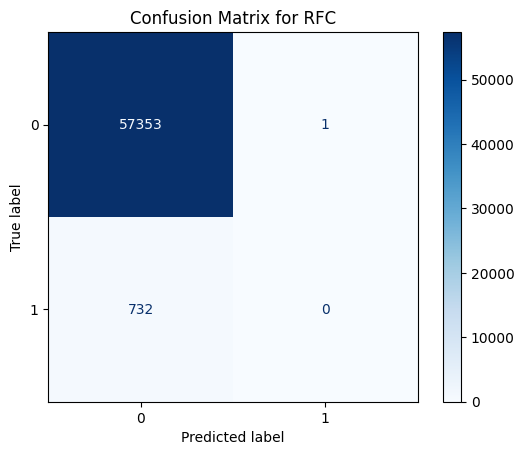

In [156]:
y_pred = rfc.predict(X_test)
evaluate_model(y_pred, y_test, "RFC")

# BURNING, LABELED DATA REMOVED
# MCC: -0.0005


In [ ]:
import numpy as np
import pandas as pd
import plotly.graph_objects as go
from sklearn.model_selection import TimeSeriesSplit
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, matthews_corrcoef

# Ensure the timestamp column is in datetime format
merged_df["timestamp(ZG)"] = pd.to_datetime(merged_df["timestamp(ZG)"])

# Prepare containers for aggregated predictions and ground truth
all_y_test = []
all_y_pred = []
fold_accuracies = []
fold_mccs = []

# Define TimeSeriesSplit (e.g., 5 folds)
tscv = TimeSeriesSplit(n_splits=5)
fold = 1

# Define your features and target.
features = ['NetCO2-CO2_ug', 'NetADC_O3-O3_ug', 'NetADC_CO-CO_ug',
            'NetPM-PM10(µg/m3)', 'NetPM-PM25(µg/m3)', 'NetPid_P1-PPB_ug',
            'NetADC_NO2-NO2_ug','BCbb','BCff','BC6']

# Assume sensor_df_normalized and merged_df are already defined.
X = sensor_df_normalized[features].values
y = merged_df['burning'].values

for train_index, test_index in tscv.split(X):
    print(f"\nFold {fold}")
    
    # Print the time interval for the test set of this fold
    start_time = merged_df["timestamp(ZG)"].iloc[test_index[0]]
    end_time = merged_df["timestamp(ZG)"].iloc[test_index[-1]]
    print(f"Time interval for fold {fold}: {start_time} to {end_time}")
    
    # Create training and test sets for current fold
    X_train_fold, X_test_fold = X[train_index], X[test_index]
    y_train_fold, y_test_fold = y[train_index], y[test_index]
    
    # Initialize and train the RandomForestClassifier for the current fold
    rfc = RandomForestClassifier(random_state=42)
    rfc.fit(X_train_fold, y_train_fold.ravel())
    
    # Get binary predictions on the test set of the current fold
    y_pred_fold = rfc.predict(X_test_fold)
    
    # Evaluate predictions using accuracy and MCC
    accuracy = accuracy_score(y_test_fold, y_pred_fold)
    mcc = matthews_corrcoef(y_test_fold, y_pred_fold)
    print(f"Fold {fold} - Accuracy: {accuracy:.4f}, MCC: {mcc:.4f}")
    fold_accuracies.append(accuracy)
    fold_mccs.append(mcc)
    
    # Store the predictions and ground truth for later aggregation
    all_y_test.append(y_test_fold)
    all_y_pred.append(y_pred_fold)
    
    # --- Create Interactive Plot using Plotly for the current fold ---
    # Get the corresponding timestamps for the test set
    fold_timestamps = merged_df["timestamp(ZG)"].iloc[test_index].reset_index(drop=True)
    # Flatten the arrays in case they're 2D
    y_test_flat = y_test_fold.flatten()
    y_pred_flat = y_pred_fold.flatten()
    
    # Create a DataFrame for plotting
    df_plot = pd.DataFrame({
        'timestamp': fold_timestamps,
        'Actual': y_test_flat,
        'Predicted': y_pred_flat
    })
    
    # Create interactive Plotly figure
    fig = go.Figure()
    
    fig.add_trace(go.Scatter(
        x=df_plot['timestamp'],
        y=df_plot['Actual'],
        mode='lines',
        name='Actual People'
    ))
    fig.add_trace(go.Scatter(
        x=df_plot['timestamp'],
        y=df_plot['Predicted'],
        mode='lines',
        name='Predicted People',
        line=dict(dash='dot')
    ))
    
    fig.update_layout(
        title=f'Fold {fold} Actual vs Predicted People',
        xaxis_title='Time',
        yaxis_title='People Value',
        width=1400,
        height=700,
        xaxis=dict(
            rangeselector=dict(
                buttons=list([
                    dict(count=1, label="1d", step="day", stepmode="backward"),
                    dict(step="all")
                ])
            ),
            rangeslider=dict(visible=True),
            type="date"
        )
    )
    
    fig.show()
    # ---------------------------------------------------------
    
    fold += 1

# Concatenate the arrays from all folds
all_y_test = np.concatenate(all_y_test, axis=0)
all_y_pred = np.concatenate(all_y_pred, axis=0)

print(f"List of fold accuracies: {fold_accuracies}")
print(f"List of fold MCC's: {fold_mccs}")


In [ ]:
evaluate_model(all_y_pred, all_y_test, "RFC Cross-Validated")


# GRU

In [152]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from tqdm import tqdm
from sklearn.model_selection import train_test_split
from sklearn.metrics import matthews_corrcoef
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import GRU, Dense, Dropout
from tensorflow.keras.callbacks import EarlyStopping

# Define your features and target.
features = ['NetCO2-CO2_ug', 'NetADC_O3-O3_ug', 'NetADC_CO-CO_ug',
            'NetPM-PM10(µg/m3)', 'NetPM-PM25(µg/m3)', 'NetPid_P1-PPB_ug',
            'NetADC_NO2-NO2_ug','BCbb','BCff','BC6']

# Assume sensor_df_normalized and merged_df are already defined.
X = sensor_df_normalized[features].values
y = merged_df['burning'].values

# Split data (using a simple train/test split).
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=False)

# Reshape data for GRU input (samples, timesteps, features).
# Here we use a single timestep.
X_train = X_train.reshape(X_train.shape[0], 1, X_train.shape[1])
X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])

# Build the GRU model.
model = Sequential([
    GRU(16, activation='tanh', return_sequences=False, 
        input_shape=(X_train.shape[1], X_train.shape[2])),
    Dropout(0.2),
    Dense(8, activation='relu'),
    Dropout(0.2),
    Dense(1, activation='sigmoid')  # For binary classification
])

# Compile the model.
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# Define early stopping.
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

# Train the model.
history = model.fit(
    X_train, y_train,
    validation_data=(X_test, y_test),
    epochs=30,
    batch_size=32,
    verbose=1,
    callbacks=[early_stopping]
)

# Predict probabilities on the test set.
y_pred_prob = model.predict(X_test)

Epoch 1/30


C:\Users\tjura\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



7261/7261 ━━━━━━━━━━━━━━━━━━━━ 20s 2ms/step - accuracy: 0.9808 - loss: 0.0861 - val_accuracy: 0.9756 - val_loss: 0.0497
Epoch 2/30
7261/7261 ━━━━━━━━━━━━━━━━━━━━ 26s 3ms/step - accuracy: 0.9911 - loss: 0.0236 - val_accuracy: 0.9747 - val_loss: 0.0602
Epoch 3/30
7261/7261 ━━━━━━━━━━━━━━━━━━━━ 30s 2ms/step - accuracy: 0.9923 - loss: 0.0189 - val_accuracy: 0.9744 - val_loss: 0.0731
Epoch 4/30
7261/7261 ━━━━━━━━━━━━━━━━━━━━ 12s 2ms/step - accuracy: 0.9922 - loss: 0.0172 - val_accuracy: 0.9772 - val_loss: 0.0606
Epoch 5/30
7261/7261 ━━━━━━━━━━━━━━━━━━━━ 14s 2ms/step - accuracy: 0.9931 - loss: 0.0158 - val_accuracy: 0.9812 - val_loss: 0.0902
Epoch 6/30
7261/7261 ━━━━━━━━━━━━━━━━━━━━ 13s 2ms/step - accuracy: 0.9933 - loss: 0.0150 - val_accuracy: 0.9868 - val_loss: 0.0867
1816/1816 ━━━━━━━━━━━━━━━━━━━━ 3s 1ms/step


Best MCC: 0.5112 at Threshold: 0.007100000000000003
Results for GRU:
MCC: 0.5112
Classification Report:
               precision    recall  f1-score   support

           0       1.00      0.97      0.98     57354
           1       0.29      0.93      0.44       732

    accuracy                           0.97     58086
   macro avg       0.64      0.95      0.71     58086
weighted avg       0.99      0.97      0.98     58086

Confusion Matrix:



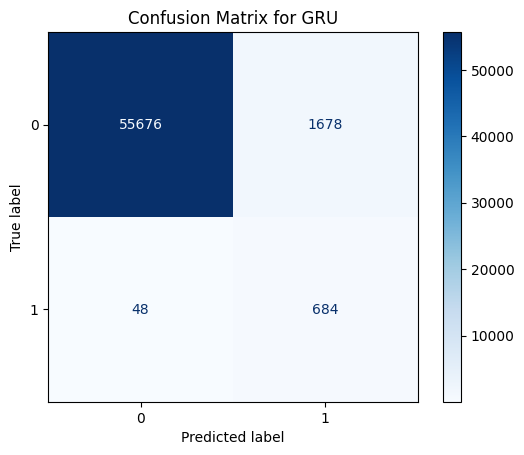

In [154]:
# IZGARANJE, REMOED LABELED DATA:
# Best MCC: 0.4674 at Threshold: 0.17899999999999985

best_mcc = -1  # MCC ranges from -1 to 1
best_threshold = 0

for threshold in np.arange(0.001, 0.2, 0.0001):
    # Binarize the predictions based on the threshold
    y_pred = (y_pred_prob > threshold).astype(int)
    
    mcc = matthews_corrcoef(y_test, y_pred)
    if mcc > best_mcc:
        best_mcc = mcc
        best_threshold = threshold

y_pred_class = (y_pred_prob > best_threshold).astype(int)

print(f"Best MCC: {best_mcc:.4f} at Threshold: {best_threshold}")
evaluate_model(y_pred_class, y_test, "GRU")

# GRU WITH CROSS-VALIDATION 

In [150]:
import numpy as np
import pandas as pd
import plotly.graph_objects as go
from sklearn.model_selection import TimeSeriesSplit
from sklearn.metrics import matthews_corrcoef
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import GRU, Dense, Dropout
from tensorflow.keras.callbacks import EarlyStopping

# Ensure the timestamp column is in datetime format
merged_df["timestamp(ZG)"] = pd.to_datetime(merged_df["timestamp(ZG)"])

# Prepare containers for aggregated predictions and ground truth
all_y_test = []
all_y_pred = []
best_mccs = []

# Define TimeSeriesSplit (e.g., 5 folds)
tscv = TimeSeriesSplit(n_splits=5)
fold = 1

# Define your features and target.
features = ['NetCO2-CO2_ug', 'NetADC_O3-O3_ug', 'NetADC_CO-CO_ug',
            'NetPM-PM10(µg/m3)', 'NetPM-PM25(µg/m3)', 'NetPid_P1-PPB_ug',
            'NetADC_NO2-NO2_ug','BCbb','BCff','BC6']

# Assume sensor_df_normalized and merged_df are already defined.
X = sensor_df_normalized[features].values
y = merged_df['burning'].values

for train_index, test_index in tscv.split(X):
    print(f"\nFold {fold}")
    
    # Print the time interval for the test set of this fold
    start_time = merged_df["timestamp(ZG)"].iloc[test_index[0]]
    end_time = merged_df["timestamp(ZG)"].iloc[test_index[-1]]
    print(f"Time interval for fold {fold}: {start_time} to {end_time}")
    
    # Create training and test sets for current fold
    X_train_fold, X_test_fold = X[train_index], X[test_index]
    y_train_fold, y_test_fold = y[train_index], y[test_index]
    
    # Reshape for GRU input (samples, timesteps, features)
    X_train_fold = X_train_fold.reshape(X_train_fold.shape[0], 1, X_train_fold.shape[1])
    X_test_fold = X_test_fold.reshape(X_test_fold.shape[0], 1, X_test_fold.shape[1])
    
    # Define a new GRU model for this fold
    model = Sequential([
        GRU(16, activation='tanh', return_sequences=False, 
            input_shape=(X_train_fold.shape[1], X_train_fold.shape[2])),
        Dropout(0.2),
        Dense(8, activation='relu'),
        Dropout(0.2),
        Dense(1, activation='sigmoid')  # Binary classification
    ])
    
    early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
    
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    
    # Train the model on the current fold
    history = model.fit(
        X_train_fold, y_train_fold,
        validation_data=(X_test_fold, y_test_fold),
        epochs=30,
        batch_size=32,
        verbose=1,
        callbacks=[early_stopping]
    )
    
    # Predict probabilities on the test set of the current fold
    y_pred_prob_fold = model.predict(X_test_fold)
    
    # Find the best threshold for this fold using MCC
    best_mcc = -1
    best_threshold = 0
    for threshold in np.arange(0.01, 0.8, 0.001):
        y_pred_temp = (y_pred_prob_fold > threshold).astype(int)
        mcc = matthews_corrcoef(y_test_fold, y_pred_temp)
        if mcc > best_mcc:
            best_mcc = mcc
            best_threshold = threshold
    
    print(f"Fold {fold} - Best MCC: {best_mcc:.4f} at Threshold: {best_threshold:.4f}")
    
    # Apply the best threshold to obtain binary predictions for this fold
    y_pred_fold = (y_pred_prob_fold > best_threshold).astype(int)
    
    # Store the predictions and ground truth for later aggregation
    all_y_test.append(y_test_fold)
    all_y_pred.append(y_pred_fold)
    best_mccs.append(best_mcc)
    
    # --- Create Interactive Plot using Plotly for the current fold ---
    # Get the corresponding timestamps for the test set
    fold_timestamps = merged_df["timestamp(ZG)"].iloc[test_index].reset_index(drop=True)
    # Flatten the arrays in case they're 2D
    y_test_flat = y_test_fold.flatten()
    y_pred_flat = y_pred_fold.flatten()
    
    # Create a DataFrame for plotting
    df_plot = pd.DataFrame({
        'timestamp': fold_timestamps,
        'Actual': y_test_flat,
        'Predicted': y_pred_flat
    })
    
    # Create interactive Plotly figure
    fig = go.Figure()
    
    fig.add_trace(go.Scatter(
        x=df_plot['timestamp'],
        y=df_plot['Actual'],
        mode='lines',
        name='Actual People'
    ))
    fig.add_trace(go.Scatter(
        x=df_plot['timestamp'],
        y=df_plot['Predicted'],
        mode='lines',
        name='Predicted People',
        line=dict(dash='dot')
    ))
    
    fig.update_layout(
        title=f'Fold {fold} Actual vs Predicted People',
        xaxis_title='Time',
        yaxis_title='People Value',
        width=1400,   # Increase the width of the plot
        height=700,   # Increase the height of the plot
        xaxis=dict(
            rangeselector=dict(
                buttons=list([
                    dict(count=1, label="1d", step="day", stepmode="backward"),
                    dict(step="all")
                ])
            ),
            rangeslider=dict(visible=True),
            type="date"
        )
    )
    
    fig.show()
    # ---------------------------------------------------------
    
    fold += 1
# Concatenate the arrays from all folds
all_y_test = np.concatenate(all_y_test, axis=0)
all_y_pred = np.concatenate(all_y_pred, axis=0)



Fold 1
Time interval for fold 1: 2024-10-16 07:12:52 to 2024-10-19 05:21:20
Epoch 1/30


C:\Users\tjura\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1513/1513 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - accuracy: 0.9691 - loss: 0.1577 - val_accuracy: 1.0000 - val_loss: 0.0322
Epoch 2/30
1513/1513 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step - accuracy: 1.0000 - loss: 0.0018 - val_accuracy: 1.0000 - val_loss: 0.0271
Epoch 3/30
1513/1513 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - accuracy: 1.0000 - loss: 0.0012 - val_accuracy: 1.0000 - val_loss: 0.0239
Epoch 4/30
1513/1513 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step - accuracy: 1.0000 - loss: 0.0012 - val_accuracy: 1.0000 - val_loss: 0.0204
Epoch 5/30
1513/1513 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - accuracy: 1.0000 - loss: 6.6914e-04 - val_accuracy: 1.0000 - val_loss: 0.0171
Epoch 6/30
1513/1513 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - accuracy: 1.0000 - loss: 5.6213e-04 - val_accuracy: 1.0000 - val_loss: 0.0135
Epoch 7/30
1513/1513 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - accuracy: 1.0000 - loss: 5.1771e-04 - val_accuracy: 1.0000 - val_loss: 0.0109
Epoch 8/30
1513/1513 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - accuracy: 1.0000 - loss: 5.0185e-

C:\Users\tjura\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\metrics\_classification.py:409: UserWarning: A single label was found in 'y_true' and 'y_pred'. For the confusion matrix to have the correct shape, use the 'labels' parameter to pass all known labels.
  warnings.warn(
C:\Users\tjura\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\metrics\_classification.py:409: UserWarning: A single label was found in 'y_true' and 'y_pred'. For the confusion matrix to have the correct shape, use the 'labels' parameter to pass all known labels.
  warnings.warn(
C:\Users\tjura\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\metrics\_classification.py:409: UserWarning: A single label was found in 'y_true' and 'y_pred'. For the confusion matrix to

Fold 1 - Best MCC: 0.0000 at Threshold: 0.0100



Fold 2
Time interval for fold 2: 2024-10-19 05:21:25 to 2024-10-22 06:24:21


C:\Users\tjura\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



Epoch 1/30
3026/3026 ━━━━━━━━━━━━━━━━━━━━ 9s 2ms/step - accuracy: 0.9858 - loss: 0.0721 - val_accuracy: 0.9464 - val_loss: 0.6139
Epoch 2/30
3026/3026 ━━━━━━━━━━━━━━━━━━━━ 6s 2ms/step - accuracy: 1.0000 - loss: 1.7337e-04 - val_accuracy: 0.9464 - val_loss: 0.8321
Epoch 3/30
3026/3026 ━━━━━━━━━━━━━━━━━━━━ 6s 2ms/step - accuracy: 1.0000 - loss: 5.1927e-05 - val_accuracy: 0.9464 - val_loss: 1.0639
Epoch 4/30
3026/3026 ━━━━━━━━━━━━━━━━━━━━ 11s 2ms/step - accuracy: 1.0000 - loss: 1.4905e-05 - val_accuracy: 0.9464 - val_loss: 1.2353
Epoch 5/30
3026/3026 ━━━━━━━━━━━━━━━━━━━━ 10s 2ms/step - accuracy: 1.0000 - loss: 1.6149e-05 - val_accuracy: 0.9464 - val_loss: 1.5890
Epoch 6/30
3026/3026 ━━━━━━━━━━━━━━━━━━━━ 6s 2ms/step - accuracy: 1.0000 - loss: 5.6489e-07 - val_accuracy: 0.9464 - val_loss: 1.8516
1513/1513 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step
Fold 2 - Best MCC: 0.0000 at Threshold: 0.4520



Fold 3
Time interval for fold 3: 2024-10-22 06:24:26 to 2024-10-25 11:38:04


C:\Users\tjura\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



Epoch 1/30
4538/4538 ━━━━━━━━━━━━━━━━━━━━ 10s 2ms/step - accuracy: 0.9763 - loss: 0.1213 - val_accuracy: 0.9980 - val_loss: 0.0233
Epoch 2/30
4538/4538 ━━━━━━━━━━━━━━━━━━━━ 8s 2ms/step - accuracy: 0.9857 - loss: 0.0359 - val_accuracy: 0.9988 - val_loss: 0.0132
Epoch 3/30
4538/4538 ━━━━━━━━━━━━━━━━━━━━ 8s 2ms/step - accuracy: 0.9867 - loss: 0.0310 - val_accuracy: 0.9997 - val_loss: 0.0055
Epoch 4/30
4538/4538 ━━━━━━━━━━━━━━━━━━━━ 9s 2ms/step - accuracy: 0.9881 - loss: 0.0277 - val_accuracy: 0.9996 - val_loss: 0.0049
Epoch 5/30
4538/4538 ━━━━━━━━━━━━━━━━━━━━ 8s 2ms/step - accuracy: 0.9890 - loss: 0.0254 - val_accuracy: 0.9999 - val_loss: 0.0017
Epoch 6/30
4538/4538 ━━━━━━━━━━━━━━━━━━━━ 11s 2ms/step - accuracy: 0.9900 - loss: 0.0233 - val_accuracy: 1.0000 - val_loss: 0.0013
Epoch 7/30
4538/4538 ━━━━━━━━━━━━━━━━━━━━ 10s 2ms/step - accuracy: 0.9902 - loss: 0.0229 - val_accuracy: 1.0000 - val_loss: 0.0011
Epoch 8/30
4538/4538 ━━━━━━━━━━━━━━━━━━━━ 10s 2ms/step - accuracy: 0.9905 - loss: 0.022

C:\Users\tjura\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\metrics\_classification.py:409: UserWarning:

A single label was found in 'y_true' and 'y_pred'. For the confusion matrix to have the correct shape, use the 'labels' parameter to pass all known labels.

C:\Users\tjura\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\metrics\_classification.py:409: UserWarning:

A single label was found in 'y_true' and 'y_pred'. For the confusion matrix to have the correct shape, use the 'labels' parameter to pass all known labels.

C:\Users\tjura\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\metrics\_classification.py:409: UserWarning:

A single label was found in 'y_true' and 'y_pred'. For the confusion matrix to have the correct shape, use 

Fold 3 - Best MCC: 0.0000 at Threshold: 0.0100



Fold 4
Time interval for fold 4: 2024-10-25 11:38:09 to 2024-10-28 07:47:45


C:\Users\tjura\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



Epoch 1/30
6051/6051 ━━━━━━━━━━━━━━━━━━━━ 13s 2ms/step - accuracy: 0.9835 - loss: 0.0956 - val_accuracy: 1.0000 - val_loss: 5.9705e-04
Epoch 2/30
6051/6051 ━━━━━━━━━━━━━━━━━━━━ 11s 2ms/step - accuracy: 0.9888 - loss: 0.0290 - val_accuracy: 1.0000 - val_loss: 1.1201e-04
Epoch 3/30
6051/6051 ━━━━━━━━━━━━━━━━━━━━ 11s 2ms/step - accuracy: 0.9901 - loss: 0.0240 - val_accuracy: 1.0000 - val_loss: 4.1997e-05
Epoch 4/30
6051/6051 ━━━━━━━━━━━━━━━━━━━━ 11s 2ms/step - accuracy: 0.9912 - loss: 0.0216 - val_accuracy: 1.0000 - val_loss: 4.8493e-05
Epoch 5/30
6051/6051 ━━━━━━━━━━━━━━━━━━━━ 11s 2ms/step - accuracy: 0.9914 - loss: 0.0199 - val_accuracy: 1.0000 - val_loss: 3.5556e-05
Epoch 6/30
6051/6051 ━━━━━━━━━━━━━━━━━━━━ 21s 2ms/step - accuracy: 0.9922 - loss: 0.0181 - val_accuracy: 1.0000 - val_loss: 2.4474e-04
Epoch 7/30
6051/6051 ━━━━━━━━━━━━━━━━━━━━ 11s 2ms/step - accuracy: 0.9923 - loss: 0.0179 - val_accuracy: 1.0000 - val_loss: 5.8158e-04
Epoch 8/30
6051/6051 ━━━━━━━━━━━━━━━━━━━━ 11s 2ms/step 

C:\Users\tjura\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\metrics\_classification.py:409: UserWarning:

A single label was found in 'y_true' and 'y_pred'. For the confusion matrix to have the correct shape, use the 'labels' parameter to pass all known labels.

C:\Users\tjura\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\metrics\_classification.py:409: UserWarning:

A single label was found in 'y_true' and 'y_pred'. For the confusion matrix to have the correct shape, use the 'labels' parameter to pass all known labels.

C:\Users\tjura\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\metrics\_classification.py:409: UserWarning:

A single label was found in 'y_true' and 'y_pred'. For the confusion matrix to have the correct shape, use 

Fold 4 - Best MCC: 0.0000 at Threshold: 0.0100



Fold 5
Time interval for fold 5: 2024-10-28 07:47:50 to 2024-10-31 11:22:12


C:\Users\tjura\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



Epoch 1/30
7564/7564 ━━━━━━━━━━━━━━━━━━━━ 15s 2ms/step - accuracy: 0.9891 - loss: 0.0630 - val_accuracy: 0.9849 - val_loss: 0.0657
Epoch 2/30
7564/7564 ━━━━━━━━━━━━━━━━━━━━ 20s 2ms/step - accuracy: 0.9900 - loss: 0.0218 - val_accuracy: 0.9707 - val_loss: 0.0689
Epoch 3/30
7564/7564 ━━━━━━━━━━━━━━━━━━━━ 13s 2ms/step - accuracy: 0.9924 - loss: 0.0174 - val_accuracy: 0.9714 - val_loss: 0.0774
Epoch 4/30
7564/7564 ━━━━━━━━━━━━━━━━━━━━ 21s 2ms/step - accuracy: 0.9932 - loss: 0.0160 - val_accuracy: 0.9719 - val_loss: 0.1048
Epoch 5/30
7564/7564 ━━━━━━━━━━━━━━━━━━━━ 20s 2ms/step - accuracy: 0.9934 - loss: 0.0149 - val_accuracy: 0.9732 - val_loss: 0.1099
Epoch 6/30
7564/7564 ━━━━━━━━━━━━━━━━━━━━ 13s 2ms/step - accuracy: 0.9940 - loss: 0.0141 - val_accuracy: 0.9763 - val_loss: 0.1388
1513/1513 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step
Fold 5 - Best MCC: 0.4640 at Threshold: 0.0100


List of best MCC's: [0.0, 0.0, 0.0, 0.0, 0.4640455137594486]


Results for GRU Cross-Validated:
MCC: 0.2060
Classification Report:
               precision    recall  f1-score   support

           0       0.99      0.99      0.99    238695
           1       0.27      0.17      0.21      3325

    accuracy                           0.98    242020
   macro avg       0.63      0.58      0.60    242020
weighted avg       0.98      0.98      0.98    242020

Confusion Matrix:



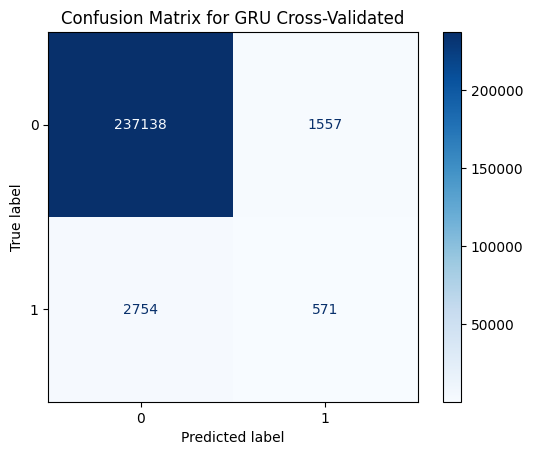

In [151]:
# Use your evaluate_model function on the aggregated predictions
print(f"List of best MCC's: {best_mccs}")
evaluate_model(all_y_pred, all_y_test, "GRU Cross-Validated")
